In [ ]:
# 중력방향 정렬
import trimesh
import numpy as np
from scipy.spatial.transform import Rotation

# GLB 로드
scene = trimesh.load('/data/ephemeral/home/glb_folder/giant_by_pose_intrincics.glb')

# ARCore 중력 방향 → GLB 계산
arcore_y = np.array([0, 1, 0])
gl_to_cv = np.array([[1, 0, 0], [0, -1, 0], [0, 0, -1]])
A = np.array(scene.metadata.get('hf_alignment', np.eye(4))).reshape(4, 4)
gravity = (A[:3, :3] @ gl_to_cv @ arcore_y)
gravity = gravity / np.linalg.norm(gravity)

# Z+ 방향으로 회전
R = Rotation.align_vectors([[0, 0, 1]], [gravity])[0]
T = np.eye(4)
T[:3, :3] = R.as_matrix()
for geom in scene.geometry.values():
    geom.apply_transform(T)

In [ ]:
# 렌더링 확인
# 축 길이 설정
axis_length = 1

# 원점 (0, 0, 0) 사용
origin = np.array([0, 0, 0])

# 원점 (0, 0, 0)에 포인트 생성
# 방법 1: 작은 구(sphere) 사용
origin_point = trimesh.creation.icosphere(radius=0.02)  # 반지름 0.01
origin_point.apply_translation([0, 0, 0])  # 원점으로 이동
origin_point.visual.face_colors = [255, 255, 0, 255]  # 노란색


# X축 (빨강)
x_line = trimesh.creation.cylinder(radius=0.0005, height=axis_length)
x_line.apply_transform(trimesh.transformations.rotation_matrix(
    np.pi/2, [0, 1, 0], [0, 0, 0]
))
x_line.apply_translation(origin + [axis_length/2, 0, 0])  # 원점 기준
x_line.visual.face_colors = [255, 0, 0, 255]

# Y축 (초록)
y_line = trimesh.creation.cylinder(radius=0.0005, height=axis_length)
y_line.apply_transform(trimesh.transformations.rotation_matrix(
    -np.pi/2, [1, 0, 0], [0, 0, 0]
))
y_line.apply_translation(origin + [0, axis_length/2, 0])  # 원점 기준
y_line.visual.face_colors = [0, 255, 0, 255]

# Z축 (파랑)
z_line = trimesh.creation.cylinder(radius=0.0005, height=axis_length)
z_line.apply_translation(origin + [0, 0, axis_length/2])  # 원점 기준
z_line.visual.face_colors = [0, 0, 255, 255]

# 씬에 추가
scene.add_geometry([x_line, y_line, z_line,origin_point])
scene.show()

/tmp/ipykernel_715038/1265620227.py:69: UserWarning: Glyph 45800 (\N{HANGUL SYLLABLE DAN}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipykernel_715038/1265620227.py:69: UserWarning: Glyph 47732 (\N{HANGUL SYLLABLE MYEON}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipykernel_715038/1265620227.py:69: UserWarning: Glyph 54217 (\N{HANGUL SYLLABLE PYEONG}) missing from font(s) DejaVu Sans.
  plt.tight_layout()


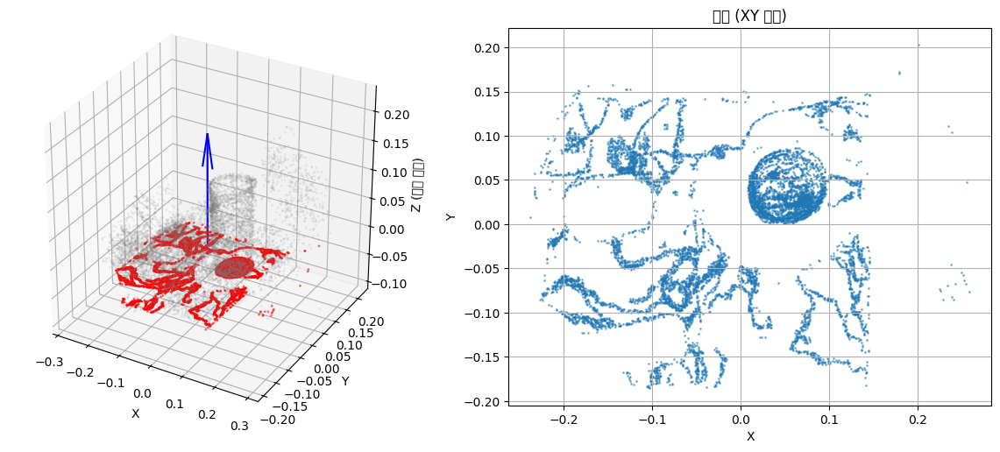

In [9]:
# 단면 시각화
import trimesh
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.transform import Rotation

# GLB 로드
scene = trimesh.load('/data/ephemeral/home/project/output/scene.glb')

# ARCore 중력 방향 → GLB 계산
arcore_y = np.array([0, 1, 0])
gl_to_cv = np.array([[1, 0, 0], [0, -1, 0], [0, 0, -1]])
A = np.array(scene.metadata.get('hf_alignment', np.eye(4))).reshape(4, 4)
gravity = (A[:3, :3] @ gl_to_cv @ arcore_y)
gravity = gravity / np.linalg.norm(gravity)

# Z+ 방향으로 회전
R = Rotation.align_vectors([[0, 0, 1]], [gravity])[0]
T = np.eye(4)
T[:3, :3] = R.as_matrix()
for geom in scene.geometry.values():
    geom.apply_transform(T)

# 회전 후 포인트 클라우드 가져오기
points = None
for name, geometry in scene.geometry.items():
    if isinstance(geometry, trimesh.PointCloud):
        points = geometry.vertices
        break

# 단면 추출 (회전 후에는 Z+ 방향이 중력 방향)
plane_origin = np.array([0, 0,-0.04])  # Z 좌표로 높이 설정
plane_normal = np.array([0, 0, 1])  # Z+ 방향 (회전 후 중력 방향)
thickness = 0.0003

distances = np.abs(np.dot(points - plane_origin, plane_normal))
slice_mask = distances < thickness
slice_points = points[slice_mask]

# 시각화
fig = plt.figure(figsize=(12, 5))

# 3D
ax1 = fig.add_subplot(1, 2, 1, projection='3d')
if len(points) > 10000:
    sample = points[np.random.choice(len(points), 10000, replace=False)]
else:
    sample = points
ax1.scatter(sample[:, 0], sample[:, 1], sample[:, 2], c='gray', alpha=0.1, s=1)
ax1.scatter(slice_points[:, 0], slice_points[:, 1], slice_points[:, 2], c='red', alpha=0.5, s=1)
# 회전 후에는 Z+ 방향이 중력 방향
ax1.quiver(0, 0, 0, 0, 0, 0.2, color='blue', arrow_length_ratio=0.3)
ax1.set_box_aspect([1,1,1])
ax1.set_xlabel('X')
ax1.set_ylabel('Y')
ax1.set_zlabel('Z (중력 방향)')

# 2D 투영 (XY 평면으로 투영)
ax2 = fig.add_subplot(1, 2, 2)
# 회전 후에는 Z+가 중력 방향이므로, XY 평면이 단면
slice_2d = slice_points[:, :2]  # X, Y 좌표만 사용
ax2.scatter(slice_2d[:, 0], slice_2d[:, 1], alpha=0.5, s=1)
ax2.set_aspect('equal')
ax2.grid(True)
ax2.set_xlabel('X')
ax2.set_ylabel('Y')
ax2.set_title('단면 (XY 평면)')

plt.tight_layout()
plt.show()

In [10]:
# 원 단면 시각화 함수

def find_and_visualize_circle_at_height(
    scene,
    z_height,
    thickness=0.003,
    origin=np.array([0, 0]),
    n_iterations=50,
    threshold=0.005,
    distance_filter=0.2,
    min_height=-0.1,
    max_height=0.15,
    figsize=(10, 8)
):
    """
    특정 z 높이에서 단면을 추출하고 RANSAC으로 원을 찾아 시각화하는 함수.
    조건을 만족하지 않아도 시각화합니다.
    
    Parameters:
    -----------
    scene : trimesh.Scene
        GLB 파일에서 로드한 씬 객체 (이미 중력 방향으로 정렬됨)
    z_height : float
        원을 찾을 z 높이 (미터 단위)
    thickness : float, default=0.003
        단면의 두께 (z_height ± thickness 범위의 포인트 사용)
    origin : np.ndarray, default=[0, 0]
        원점 좌표 (XY 평면)
    n_iterations : int, default=50
        RANSAC 반복 횟수
    threshold : float, default=0.005
        RANSAC inlier 임계값 (미터 단위)
    distance_filter : float, default=0.2
        원점으로부터의 최대 거리 (필터링용)
    min_height : float, default=-0.1
        최소 높이 필터
    max_height : float, default=0.15
        최대 높이 필터
    figsize : tuple, default=(10, 8)
        시각화 그림 크기
    
    Returns:
    --------
    dict or None
        원을 찾은 경우: {
            'center': np.ndarray,  # 원의 중심 (x, y)
            'radius': float,        # 반지름
            'z': float,             # z 높이
            'score': float,         # 점수
            'n_inliers': int,       # inlier 개수
            'inlier_points': np.ndarray,  # inlier 포인트들
            'outlier_points': np.ndarray, # outlier 포인트들
            'all_points': np.ndarray,      # 전체 포인트들
            'is_valid': bool        # 조건을 만족하는지 여부
        }
        원을 찾지 못한 경우: {
            'center': None,
            'radius': None,
            'z': z_height,
            'score': None,
            'n_inliers': 0,
            'inlier_points': np.array([]),
            'outlier_points': np.array([]),
            'all_points': np.ndarray,  # 전체 포인트들
            'is_valid': False
        }
    """
    import trimesh
    import numpy as np
    import matplotlib.pyplot as plt
    import matplotlib.patches as patches
    from scipy.optimize import least_squares
    
    # ===== 1. 포인트 클라우드 추출 =====
    points = None
    for name, geometry in scene.geometry.items():
        if isinstance(geometry, trimesh.PointCloud):
            points = geometry.vertices
            break
    
    if points is None:
        print("⚠️ 포인트 클라우드를 찾을 수 없습니다.")
        return None
    
    # ===== 2. 원점 근처 필터링 (선택적) =====
    distances = np.linalg.norm(points[:, :2], axis=1)
    heights = points[:, 2]
    mask = (distances < distance_filter) & (heights > min_height) & (heights < max_height)
    filtered_points = points[mask]
    
    if len(filtered_points) == 0:
        print(f"⚠️ 필터링 후 포인트가 없습니다. (거리<{distance_filter}m, 높이 {min_height}~{max_height}m)")
        return None
    
    # ===== 3. 특정 z 높이에서 단면 추출 =====
    h_min = z_height - thickness
    h_max = z_height + thickness
    
    # 높이 범위 내의 포인트 필터링
    height_mask = (filtered_points[:, 2] >= h_min) & (filtered_points[:, 2] <= h_max)
    slice_points = filtered_points[height_mask]
    
    if len(slice_points) < 3:
        print(f"⚠️ z={z_height:.4f}m 높이에서 포인트가 부족합니다. (필요: 3개 이상, 실제: {len(slice_points)}개)")
        # 포인트가 부족해도 시각화는 진행
        if len(slice_points) == 0:
            return None
        slice_2d = slice_points[:, :2]
        # 원 없이 포인트만 시각화
        fig, ax = plt.subplots(1, 1, figsize=figsize)
        ax.scatter(slice_2d[:, 0], slice_2d[:, 1], c='gray', alpha=0.5, s=10, label='포인트')
        ax.scatter(origin[0], origin[1], c='green', s=100, marker='o', 
                  edgecolors='black', linewidths=2, label='원점')
        ax.set_xlabel('X (m)', fontsize=12)
        ax.set_ylabel('Y (m)', fontsize=12)
        ax.set_title(f'단면 원 검출 결과 (Z={z_height:.4f}m) - 포인트 부족', fontsize=14, fontweight='bold')
        ax.set_aspect('equal')
        ax.grid(True, alpha=0.3)
        ax.legend(loc='upper right', fontsize=9)
        plt.tight_layout()
        plt.show()
        
        return {
            'center': None,
            'radius': None,
            'z': z_height,
            'score': None,
            'n_inliers': 0,
            'inlier_points': np.array([]),
            'outlier_points': np.array([]),
            'all_points': slice_2d,
            'is_valid': False
        }
    
    # XY 평면으로 투영
    slice_2d = slice_points[:, :2]
    
    # ===== 4. RANSAC으로 원 찾기 =====
    # 최소제곱법으로 원 정밀 피팅 함수
    def refine_circle_with_least_squares(inlier_points):
        if len(inlier_points) < 3:
            return None
        
        center_init = inlier_points.mean(axis=0)
        radius_init = np.mean(np.linalg.norm(inlier_points - center_init, axis=1))
        
        def residuals(params):
            cx, cy, r = params
            distances = np.linalg.norm(inlier_points - [cx, cy], axis=1)
            return distances - r
        
        try:
            result = least_squares(
                residuals, 
                [center_init[0], center_init[1], radius_init],
                bounds=([-0.5, -0.5, 0.001], [0.5, 0.5, 0.2])
            )
            
            cx, cy, r = result.x
            
            if 0.01 < r < 0.15:
                return {'center': np.array([cx, cy]), 'radius': r}
        except:
            pass
        
        return None
    
    # RANSAC으로 원 검출 함수
    def fit_circle_ransac(points_2d, n_iterations=50, threshold=0.005, min_inliers=10):
        if len(points_2d) < 3:
            return None
        
        best_circle = None
        best_score = 0
        
        for _ in range(n_iterations):
            sample_indices = np.random.choice(len(points_2d), 3, replace=False)
            p1, p2, p3 = points_2d[sample_indices]
            
            try:
                A = np.array([
                    [2*(p2[0]-p1[0]), 2*(p2[1]-p1[1])],
                    [2*(p3[0]-p1[0]), 2*(p3[1]-p1[1])]
                ])
                b = np.array([
                    p2[0]**2 - p1[0]**2 + p2[1]**2 - p1[1]**2,
                    p3[0]**2 - p1[0]**2 + p3[1]**2 - p1[1]**2
                ])
                
                center = np.linalg.solve(A, b)
                radius = np.linalg.norm(p1 - center)
                
                if not (0.01 < radius < 0.15):
                    continue
                
                distances = np.abs(np.linalg.norm(points_2d - center, axis=1) - radius)
                inliers = distances < threshold
                n_inliers = np.sum(inliers)
                
                if n_inliers < min_inliers:
                    continue
                
                score = n_inliers / len(points_2d)
                
                if score > best_score:
                    best_score = score
                    inlier_points = points_2d[inliers]
                    
                    refined_circle = refine_circle_with_least_squares(inlier_points)
                    
                    if refined_circle is not None:
                        best_circle = {
                            'center': refined_circle['center'],
                            'radius': refined_circle['radius'],
                            'score': score,
                            'n_inliers': n_inliers,
                            'inlier_points': inlier_points,
                            'outlier_points': points_2d[~inliers]
                        }
            except np.linalg.LinAlgError:
                continue
        
        return best_circle
    
    # 원 찾기
    circle = fit_circle_ransac(slice_2d, n_iterations=n_iterations, 
                               threshold=threshold, min_inliers=10)
    
    # 원점 거리 체크 및 점수 조정
    is_valid = False
    dist_from_origin = None
    final_score = None
    
    if circle is not None:
        dist_from_origin = np.linalg.norm(circle['center'] - origin)
        final_score = circle['score'] - dist_from_origin * 1.5
        is_valid = (final_score > 0.2 and dist_from_origin < 0.15)
        
        if not is_valid:
            print(f"⚠️ z={z_height:.4f}m 높이에서 찾은 원이 조건을 만족하지 않습니다.")
            print(f"   점수: {final_score:.3f}, 원점 거리: {dist_from_origin:.4f}m")
            print(f"   (조건: 점수 > 0.2, 원점 거리 < 0.15m)")
            print(f"   하지만 시각화는 진행합니다.")
    
    # ===== 5. 시각화 =====
    fig, ax = plt.subplots(1, 1, figsize=figsize)
    
    all_points = slice_2d
    
    if circle is not None:
        inlier_points = circle.get('inlier_points', None)
        outlier_points = circle.get('outlier_points', None)
        center = circle['center']
        radius = circle['radius']
        
        # 전체 포인트 (회색)
        ax.scatter(all_points[:, 0], all_points[:, 1], 
                  c='gray', alpha=0.2, s=5, label='전체 포인트')
        
        # Outlier 포인트 (노란색)
        if outlier_points is not None and len(outlier_points) > 0:
            ax.scatter(outlier_points[:, 0], outlier_points[:, 1], 
                      c='yellow', alpha=0.4, s=8, label='Outlier')
        
        # Inlier 포인트 (빨간색) - 컵으로 판단된 점들
        if inlier_points is not None and len(inlier_points) > 0:
            ax.scatter(inlier_points[:, 0], inlier_points[:, 1], 
                      c='red', alpha=0.6, s=10, label='Inlier (컵)')
        
        # 피팅된 원 그리기 (파란색 점선)
        circle_patch = patches.Circle(center, radius, fill=False, 
                                     edgecolor='blue', linewidth=2, 
                                     linestyle='--', label='피팅된 원')
        ax.add_patch(circle_patch)
        
        # 원의 중심 표시
        ax.scatter(center[0], center[1], c='blue', s=200, 
                  marker='+', linewidths=3, label='원 중심')
        
        # 중심에서 원점까지 선
        ax.plot([origin[0], center[0]], [origin[1], center[1]], 
               'g--', alpha=0.5, linewidth=1, label='중심-원점 거리')
        
        # 정보 텍스트
        info_text = f"Z 높이: {z_height:.4f}m\n"
        info_text += f"단면 두께: ±{thickness:.4f}m\n"
        info_text += f"포인트 개수: {len(slice_points)}개\n\n"
        info_text += f"원 중심: ({center[0]:.4f}, {center[1]:.4f})\n"
        info_text += f"반지름: {radius:.4f}m\n"
        info_text += f"점수: {circle['score']:.3f}\n"
        info_text += f"Inlier: {circle['n_inliers']}개\n"
        if dist_from_origin is not None:
            info_text += f"원점 거리: {dist_from_origin:.4f}m\n"
        if final_score is not None:
            info_text += f"최종 점수: {final_score:.3f}\n"
        
        # 조건 만족 여부 표시
        if is_valid:
            info_text += "\n✅ 조건 만족"
        else:
            info_text += "\n⚠️ 조건 불만족"
        
    else:
        # 원을 찾지 못한 경우
        print(f"❌ z={z_height:.4f}m 높이에서 원을 찾지 못했습니다.")
        print(f"   하지만 포인트는 시각화합니다.")
        
        # 전체 포인트만 표시
        ax.scatter(all_points[:, 0], all_points[:, 1], 
                  c='gray', alpha=0.5, s=10, label='포인트')
        
        # 정보 텍스트
        info_text = f"Z 높이: {z_height:.4f}m\n"
        info_text += f"단면 두께: ±{thickness:.4f}m\n"
        info_text += f"포인트 개수: {len(slice_points)}개\n\n"
        info_text += "❌ 원을 찾지 못했습니다."
        
        center = None
        radius = None
    
    # 원점 표시
    ax.scatter(origin[0], origin[1], c='green', s=100, marker='o', 
              edgecolors='black', linewidths=2, label='원점')
    
    # 정보 텍스트 박스
    ax.text(0.02, 0.98, info_text, transform=ax.transAxes,
           verticalalignment='top', bbox=dict(boxstyle='round', 
           facecolor='wheat', alpha=0.5), fontsize=10)
    
    ax.set_xlabel('X (m)', fontsize=12)
    ax.set_ylabel('Y (m)', fontsize=12)
    title = f'단면 원 검출 결과 (Z={z_height:.4f}m)'
    if circle is not None and not is_valid:
        title += ' - 조건 불만족'
    elif circle is None:
        title += ' - 원 미검출'
    ax.set_title(title, fontsize=14, fontweight='bold')
    ax.set_aspect('equal')
    ax.grid(True, alpha=0.3)
    ax.legend(loc='upper right', fontsize=9)
    
    plt.tight_layout()
    plt.show()
    
    # ===== 6. 결과 반환 =====
    if circle is not None:
        result = {
            'center': center,
            'radius': radius,
            'z': z_height,
            'score': circle['score'],
            'n_inliers': circle['n_inliers'],
            'inlier_points': inlier_points if inlier_points is not None else np.array([]),
            'outlier_points': outlier_points if outlier_points is not None else np.array([]),
            'all_points': all_points,
            'distance_from_origin': dist_from_origin,
            'final_score': final_score,
            'is_valid': is_valid
        }
        
        if is_valid:
            print(f"\n✅ 원 검출 성공!")
        else:
            print(f"\n⚠️ 원 검출되었으나 조건 불만족")
        print(f"   중심: ({center[0]:.6f}, {center[1]:.6f})")
        print(f"   반지름: {radius:.6f}m")
        print(f"   점수: {circle['score']:.3f}")
        print(f"   Inlier: {circle['n_inliers']}개")
        
        return result
    else:
        result = {
            'center': None,
            'radius': None,
            'z': z_height,
            'score': None,
            'n_inliers': 0,
            'inlier_points': np.array([]),
            'outlier_points': np.array([]),
            'all_points': all_points,
            'distance_from_origin': None,
            'final_score': None,
            'is_valid': False
        }
        return result

⚠️ z=0.0000m 높이에서 찾은 원이 조건을 만족하지 않습니다.
   점수: -0.168, 원점 거리: 0.1299m
   (조건: 점수 > 0.2, 원점 거리 < 0.15m)
   하지만 시각화는 진행합니다.


/tmp/ipykernel_715038/12385285.py:342: UserWarning: Glyph 45800 (\N{HANGUL SYLLABLE DAN}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipykernel_715038/12385285.py:342: UserWarning: Glyph 47732 (\N{HANGUL SYLLABLE MYEON}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipykernel_715038/12385285.py:342: UserWarning: Glyph 50896 (\N{HANGUL SYLLABLE WEON}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipykernel_715038/12385285.py:342: UserWarning: Glyph 44160 (\N{HANGUL SYLLABLE GEOM}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipykernel_715038/12385285.py:342: UserWarning: Glyph 52636 (\N{HANGUL SYLLABLE CUL}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipykernel_715038/12385285.py:342: UserWarning: Glyph 44208 (\N{HANGUL SYLLABLE GYEOL}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipykernel_715038/12385285.py:342: UserWarning: Glyph 44284 (\N{HANGUL SYLLABLE GWA}) missing from font(s) DejaVu Sans.


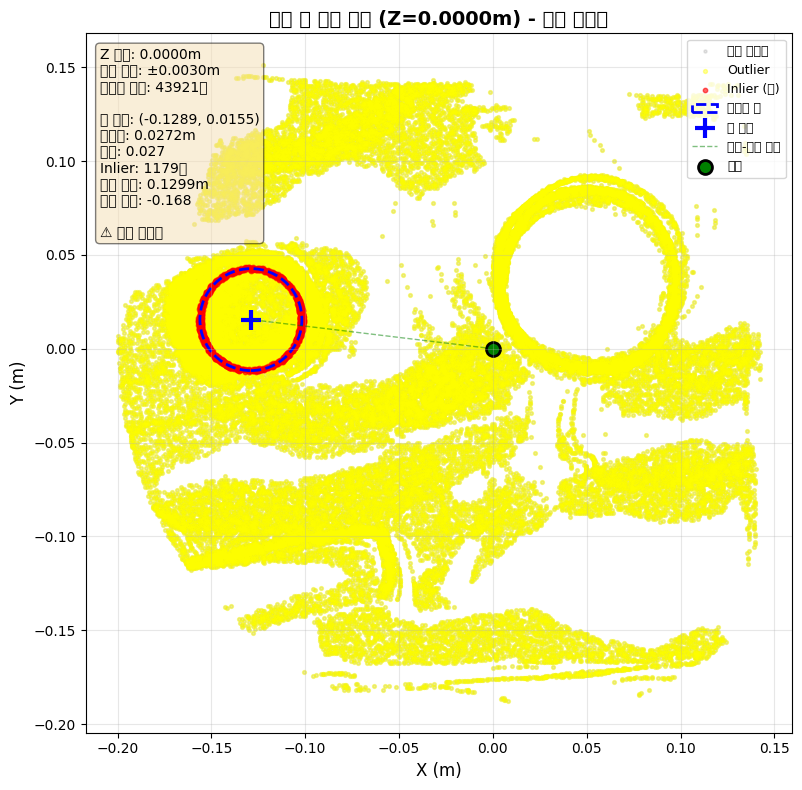


⚠️ 원 검출되었으나 조건 불만족
   중심: (-0.128931, 0.015519)
   반지름: 0.027170m
   점수: 0.027
   Inlier: 1179개
찾은 원의 중심: [-0.12893108  0.01551914]
반지름: 0.027170303215793258m


In [11]:
# 특정 z 높이에서 원 찾기.함수 사용

result = find_and_visualize_circle_at_height(
    scene=scene,
    z_height=0,  # 5cm 높이
    thickness=0.003,  # ±3mm 두께
    n_iterations=30,
    threshold=0.001
)

# 결과 사용
if result is not None:
    print(f"찾은 원의 중심: {result['center']}")
    print(f"반지름: {result['radius']}m")

/tmp/ipykernel_715038/3080845191.py:296: UserWarning: Glyph 45800 (\N{HANGUL SYLLABLE DAN}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipykernel_715038/3080845191.py:296: UserWarning: Glyph 47732 (\N{HANGUL SYLLABLE MYEON}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipykernel_715038/3080845191.py:296: UserWarning: Glyph 51473 (\N{HANGUL SYLLABLE JUNG}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipykernel_715038/3080845191.py:296: UserWarning: Glyph 49900 (\N{HANGUL SYLLABLE SIM}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipykernel_715038/3080845191.py:296: UserWarning: Glyph 48152 (\N{HANGUL SYLLABLE BAN}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipykernel_715038/3080845191.py:296: UserWarning: Glyph 51648 (\N{HANGUL SYLLABLE JI}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/tmp/ipykernel_715038/3080845191.py:296: UserWarning: Glyph 47492 (\N{HANGUL SYLLABLE REUM}) missing from font(s) De

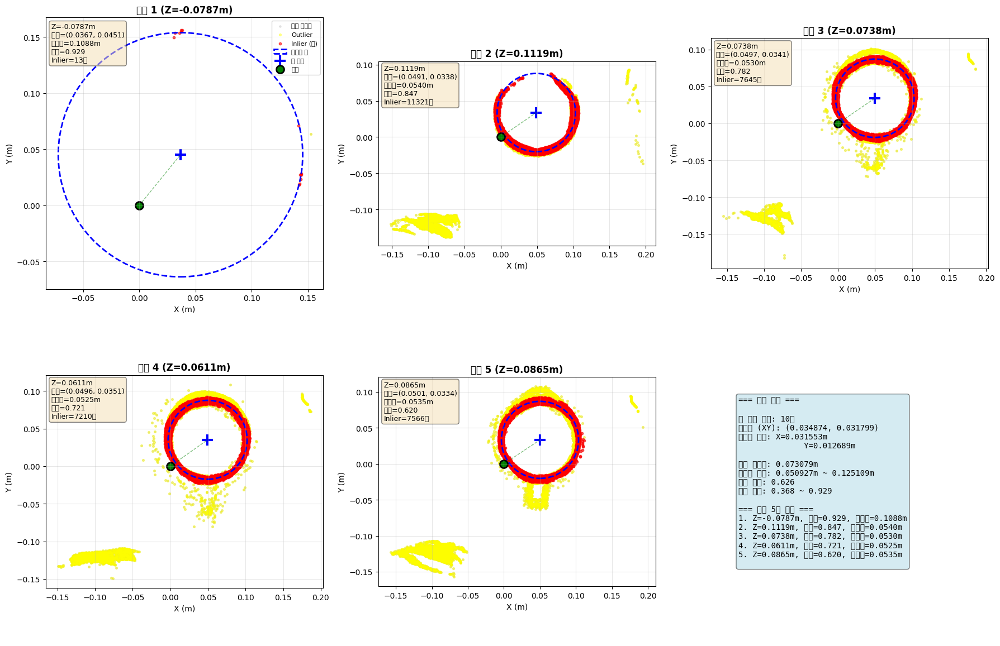


컵 중심축 (XY 평면, 상위 5개 중앙값): (0.049627, 0.034095)
사용된 원 개수: 5개 (전체 10개 중)
상위 5개 final_score 범위: 0.841 ~ 0.529


In [12]:
#ransac기반 중심축 찾기 시각화

import trimesh
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial.transform import Rotation
from scipy.optimize import least_squares
import matplotlib.patches as patches

# GLB 로드 및 회전
scene = trimesh.load('/data/ephemeral/home/project/output/scene.glb')
arcore_y = np.array([0, 1, 0])
gl_to_cv = np.array([[1, 0, 0], [0, -1, 0], [0, 0, -1]])
A = np.array(scene.metadata.get('hf_alignment', np.eye(4))).reshape(4, 4)
gravity = (A[:3, :3] @ gl_to_cv @ arcore_y)
gravity = gravity / np.linalg.norm(gravity)

R = Rotation.align_vectors([[0, 0, 1]], [gravity])[0]
T = np.eye(4)
T[:3, :3] = R.as_matrix()
for geom in scene.geometry.values():
    geom.apply_transform(T)

# 포인트 클라우드 가져오기
points = None
for name, geometry in scene.geometry.items():
    if isinstance(geometry, trimesh.PointCloud):
        points = geometry.vertices
        break

# 원점 근처 필터링
distances = np.linalg.norm(points[:, :2], axis=1)
heights = points[:, 2]
mask = (distances < 0.2) & (heights > -0.1) & (heights < 0.15)
filtered_points = points[mask]
filtered_heights = filtered_points[:, 2]

# 높이로 정렬
sorted_idx = np.argsort(filtered_heights)
sorted_points = filtered_points[sorted_idx]
sorted_heights = filtered_heights[sorted_idx]

def refine_circle_with_least_squares(inlier_points):
    """
    Inlier 포인트들로 최소제곱법으로 정확한 원 피팅
    """
    if len(inlier_points) < 3:
        return None
    
    # 초기값: Inlier들의 중심과 평균 거리
    center_init = inlier_points.mean(axis=0)
    radius_init = np.mean(np.linalg.norm(inlier_points - center_init, axis=1))
    
    def residuals(params):
        """원 방정식의 오차"""
        cx, cy, r = params
        distances = np.linalg.norm(inlier_points - [cx, cy], axis=1)
        return distances - r  # 이론 거리(r)와 실제 거리의 차이
    
    try:
        # 최소제곱법으로 최적화
        result = least_squares(
            residuals, 
            [center_init[0], center_init[1], radius_init],
            bounds=([-0.5, -0.5, 0.001], [0.5, 0.5, 0.2])
        )
        
        cx, cy, r = result.x
        
        # 검증: 반지름 범위 체크
        if 0.01 < r < 0.15:
            return {'center': np.array([cx, cy]), 'radius': r}
    except:
        pass
    
    return None

def fit_circle_ransac(points_2d, n_iterations=50, threshold=0.002, min_inliers=10):
    """
    RANSAC으로 원 검출
    """
    if len(points_2d) < 3:
        return None
    
    best_circle = None
    best_score = 0
    
    for _ in range(n_iterations):
        # 1. 랜덤하게 3개 점 선택
        sample_indices = np.random.choice(len(points_2d), 3, replace=False)
        p1, p2, p3 = points_2d[sample_indices]
        
        try:
            # 2. 3점으로 원 계산
            A = np.array([
                [2*(p2[0]-p1[0]), 2*(p2[1]-p1[1])],
                [2*(p3[0]-p1[0]), 2*(p3[1]-p1[1])]
            ])
            b = np.array([
                p2[0]**2 - p1[0]**2 + p2[1]**2 - p1[1]**2,
                p3[0]**2 - p1[0]**2 + p3[1]**2 - p1[1]**2
            ])
            
            center = np.linalg.solve(A, b)
            radius = np.linalg.norm(p1 - center)
            
            # 반지름 범위 체크
            if not (0.01 < radius < 0.15):
                continue
            
            # 3. Inlier 계산
            distances = np.abs(np.linalg.norm(points_2d - center, axis=1) - radius)
            inliers = distances < threshold
            n_inliers = np.sum(inliers)
            
            if n_inliers < min_inliers:
                continue
            
            score = n_inliers / len(points_2d)  
            
            # 4. 가장 좋은 원 선택
            if score > best_score:
                best_score = score
                inlier_points = points_2d[inliers]
                
                # ⭐ 수정: Inlier들로 최소제곱법으로 정확한 원 재피팅
                refined_circle = refine_circle_with_least_squares(inlier_points)
                
                if refined_circle is not None:
                    best_circle = {
                        'center': refined_circle['center'],
                        'radius': refined_circle['radius'],
                        'score': score,
                        'n_inliers': n_inliers,
                        'inlier_points': inlier_points,
                        'outlier_points': points_2d[~inliers]
                    }
        except np.linalg.LinAlgError:
            continue
    
    return best_circle

def find_cup_circle_ransac(slice_2d, origin=np.array([0, 0]), 
                           n_iterations=50, threshold=0.005):
    """단면에서 RANSAC으로 컵 원 찾기"""
    if len(slice_2d) < 10:
        return None
    
    circle = fit_circle_ransac(slice_2d, n_iterations=n_iterations, 
                               threshold=threshold, min_inliers=10)
    
    if circle is None:
        return None
    
    # 원점 거리 체크
    dist_from_origin = np.linalg.norm(circle['center'] - origin)
    final_score = circle['score'] - dist_from_origin * 1.5
    
    # final_score를 circle에 추가
    circle['final_score'] = final_score
    circle['dist_from_origin'] = dist_from_origin
    
    if final_score > 0.2 and dist_from_origin < 0.15:
        return circle
    
    return None

# 여러 단면에서 원 찾기
z_range = np.linspace(sorted_heights.min(), sorted_heights.max(), 20)
thickness = 0.003
circle_data = []

for z in z_range:
    h_min = z - thickness
    h_max = z + thickness
    start_idx = np.searchsorted(sorted_heights, h_min)
    end_idx = np.searchsorted(sorted_heights, h_max)
    
    if end_idx - start_idx < 10:
        continue
    
    slice_points = sorted_points[start_idx:end_idx]
    slice_2d = slice_points[:, :2]
    
    cup_circle = find_cup_circle_ransac(slice_2d, n_iterations=30, threshold=0.005)
    
    if cup_circle is not None:
        circle_data.append({
            'z': z,
            'center': cup_circle['center'],
            'radius': cup_circle['radius'],
            'score': cup_circle['score'],
            'final_score': cup_circle.get('final_score', cup_circle['score']),
            'n_inliers': cup_circle['n_inliers'],
            'all_points': slice_2d,
            'inlier_points': cup_circle.get('inlier_points', None),
            'outlier_points': cup_circle.get('outlier_points', None)
        })

# 상위 5개 단면 시각화
if len(circle_data) > 0:
    circle_data.sort(key=lambda x: x['final_score'], reverse=True)
    top_5_slices = circle_data[:5]
    
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    axes = axes.flatten()
    
    for idx, slice_info in enumerate(top_5_slices):
        ax = axes[idx]
        
        z = slice_info['z']
        center = slice_info['center']
        radius = slice_info['radius']
        all_points = slice_info['all_points']
        inlier_points = slice_info.get('inlier_points')
        outlier_points = slice_info.get('outlier_points')
        
        # 전체 포인트 (회색)
        ax.scatter(all_points[:, 0], all_points[:, 1], 
                  c='gray', alpha=0.2, s=5, label='전체 포인트')
        
        # Outlier 포인트 (노란색)
        if outlier_points is not None and len(outlier_points) > 0:
            ax.scatter(outlier_points[:, 0], outlier_points[:, 1], 
                      c='yellow', alpha=0.4, s=8, label='Outlier')
        
        # Inlier 포인트 (빨간색)
        if inlier_points is not None and len(inlier_points) > 0:
            ax.scatter(inlier_points[:, 0], inlier_points[:, 1], 
                      c='red', alpha=0.6, s=10, label='Inlier (컵)')
        
        # 피팅된 원 그리기 (파란색 점선)
        circle_patch = patches.Circle(center, radius, fill=False, 
                                     edgecolor='blue', linewidth=2, 
                                     linestyle='--', label='피팅된 원')
        ax.add_patch(circle_patch)
        
        # 원의 중심 표시
        ax.scatter(center[0], center[1], c='blue', s=200, 
                  marker='+', linewidths=3, label='원 중심')
        
        # 원점 표시
        ax.scatter(0, 0, c='green', s=100, marker='o', 
                  edgecolors='black', linewidths=2, label='원점')
        
        # 중심에서 원점까지 선
        ax.plot([0, center[0]], [0, center[1]], 'g--', alpha=0.5, linewidth=1)
        
        # 정보 텍스트
        info_text = f"Z={z:.4f}m\n중심=({center[0]:.4f}, {center[1]:.4f})\n"
        info_text += f"반지름={radius:.4f}m\n점수={slice_info['score']:.3f}\n"
        info_text += f"Inlier={slice_info['n_inliers']}개"
        ax.text(0.02, 0.98, info_text, transform=ax.transAxes,
               verticalalignment='top', bbox=dict(boxstyle='round', 
               facecolor='wheat', alpha=0.5), fontsize=9)
        
        ax.set_xlabel('X (m)')
        ax.set_ylabel('Y (m)')
        ax.set_title(f'단면 {idx+1} (Z={z:.4f}m)', fontsize=12, fontweight='bold')
        ax.set_aspect('equal')
        ax.grid(True, alpha=0.3)
        if idx == 0:
            ax.legend(loc='upper right', fontsize=8)
    
    # 마지막 칸에 통계 정보
    ax_stats = axes[5]
    ax_stats.axis('off')
    
    if len(circle_data) > 0:
        centers = np.array([c['center'] for c in circle_data])
        radii = np.array([c['radius'] for c in circle_data])
        scores = np.array([c['score'] for c in circle_data])
        
        center_axis = np.mean(centers, axis=0)
        
        stats_text = "=== 전체 통계 ===\n\n"
        stats_text += f"총 단면 개수: {len(circle_data)}개\n"
        stats_text += f"중심축 (XY): ({center_axis[0]:.6f}, {center_axis[1]:.6f})\n"
        stats_text += f"중심축 편차: X={np.std(centers[:, 0]):.6f}m\n"
        stats_text += f"              Y={np.std(centers[:, 1]):.6f}m\n\n"
        stats_text += f"평균 반지름: {radii.mean():.6f}m\n"
        stats_text += f"반지름 범위: {radii.min():.6f}m ~ {radii.max():.6f}m\n"
        stats_text += f"평균 점수: {scores.mean():.3f}\n"
        stats_text += f"점수 범위: {scores.min():.3f} ~ {scores.max():.3f}\n\n"
        stats_text += "=== 상위 5개 단면 ===\n"
        for i, s in enumerate(top_5_slices):
            stats_text += f"{i+1}. Z={s['z']:.4f}m, "
            stats_text += f"점수={s['score']:.3f}, "
            stats_text += f"반지름={s['radius']:.4f}m\n"
        
        ax_stats.text(0.1, 0.5, stats_text, transform=ax_stats.transAxes,
                     verticalalignment='center', fontsize=10,
                     family='monospace', bbox=dict(boxstyle='round', 
                     facecolor='lightblue', alpha=0.5))
    
    plt.tight_layout()
    plt.show()
    
    # 중심축 계산 및 출력 (final_score 기준 상위 5개 중앙값)
    if len(circle_data) > 0:
        # final_score 기준으로 정렬 (이미 위에서 정렬됨)
        top_5_circles = circle_data[:5]
        top_5_centers = np.array([c['center'] for c in top_5_circles])
        
        # 중앙값으로 계산
        center_axis = np.median(top_5_centers, axis=0)
        
        print(f"\n컵 중심축 (XY 평면, 상위 5개 중앙값): ({center_axis[0]:.6f}, {center_axis[1]:.6f})")
        print(f"사용된 원 개수: {len(top_5_circles)}개 (전체 {len(circle_data)}개 중)")
        if len(top_5_circles) > 0:
            print(f"상위 5개 final_score 범위: {top_5_circles[0]['final_score']:.3f} ~ {top_5_circles[-1]['final_score']:.3f}")
else:
    print("컵 원을 찾지 못했습니다.")

In [ ]:
# 중심축 기반 부피 계산
import trimesh
import numpy as np
from scipy.spatial.transform import Rotation
from scipy.optimize import least_squares

# GLB 로드 및 회전
scene = trimesh.load('/data/ephemeral/home/glb_folder/giant_by_pose_intrincics.glb')
arcore_y = np.array([0, 1, 0])
gl_to_cv = np.array([[1, 0, 0], [0, -1, 0], [0, 0, -1]])
A = np.array(scene.metadata.get('hf_alignment', np.eye(4))).reshape(4, 4)
gravity = (A[:3, :3] @ gl_to_cv @ arcore_y)
gravity = gravity / np.linalg.norm(gravity)

R = Rotation.align_vectors([[0, 0, 1]], [gravity])[0]
T = np.eye(4)
T[:3, :3] = R.as_matrix()
for geom in scene.geometry.values():
    geom.apply_transform(T)

# 포인트 클라우드 가져오기
points = None
for name, geometry in scene.geometry.items():
    if isinstance(geometry, trimesh.PointCloud):
        points = geometry.vertices
        break

# 원점 근처 필터링 (중심축 계산용 - 거리만 제한, 높이 제한 없음)
distances = np.linalg.norm(points[:, :2], axis=1)
heights = points[:, 2]
mask = distances < 0.2  # 높이 제한 제거
filtered_points = points[mask]
filtered_heights = filtered_points[:, 2]

# 높이로 정렬
sorted_idx = np.argsort(filtered_heights)
sorted_points = filtered_points[sorted_idx]
sorted_heights = filtered_heights[sorted_idx]

def refine_circle_with_least_squares(inlier_points):
    if len(inlier_points) < 3:
        return None
    
    center_init = inlier_points.mean(axis=0)
    radius_init = np.mean(np.linalg.norm(inlier_points - center_init, axis=1))
    
    def residuals(params):
        cx, cy, r = params
        distances = np.linalg.norm(inlier_points - [cx, cy], axis=1)
        return distances - r
    
    try:
        result = least_squares(
            residuals, 
            [center_init[0], center_init[1], radius_init],
            bounds=([-0.5, -0.5, 0.001], [0.5, 0.5, 0.2])
        )
        cx, cy, r = result.x
        if 0.01 < r < 0.15:
            return {'center': np.array([cx, cy]), 'radius': r}
    except:
        pass
    return None

def fit_circle_ransac(points_2d, n_iterations=50, threshold=0.002, min_inliers=10):
    if len(points_2d) < 3:
        return None
    
    best_circle = None
    best_score = 0
    
    for _ in range(n_iterations):
        sample_indices = np.random.choice(len(points_2d), 3, replace=False)
        p1, p2, p3 = points_2d[sample_indices]
        
        try:
            A = np.array([
                [2*(p2[0]-p1[0]), 2*(p2[1]-p1[1])],
                [2*(p3[0]-p1[0]), 2*(p3[1]-p1[1])]
            ])
            b = np.array([
                p2[0]**2 - p1[0]**2 + p2[1]**2 - p1[1]**2,
                p3[0]**2 - p1[0]**2 + p3[1]**2 - p1[1]**2
            ])
            
            center = np.linalg.solve(A, b)
            radius = np.linalg.norm(p1 - center)
            
            if not (0.01 < radius < 0.15):
                continue
            
            distances = np.abs(np.linalg.norm(points_2d - center, axis=1) - radius)
            inliers = distances < threshold
            n_inliers = np.sum(inliers)
            
            if n_inliers < min_inliers:
                continue
            
            score = n_inliers / len(points_2d)
            
            if score > best_score:
                best_score = score
                inlier_points = points_2d[inliers]
                refined_circle = refine_circle_with_least_squares(inlier_points)
                
                if refined_circle is not None:
                    best_circle = {
                        'center': refined_circle['center'],
                        'radius': refined_circle['radius'],
                        'score': score,
                        'n_inliers': n_inliers
                    }
        except np.linalg.LinAlgError:
            continue
    
    return best_circle

def find_cup_circle_ransac(slice_2d, origin=np.array([0, 0]), 
                           n_iterations=50, threshold=0.005):
    if len(slice_2d) < 10:
        return None
    
    circle = fit_circle_ransac(slice_2d, n_iterations=n_iterations, 
                               threshold=threshold, min_inliers=10)
    
    if circle is None:
        return None
    
    dist_from_origin = np.linalg.norm(circle['center'] - origin)
    final_score = circle['score'] - dist_from_origin * 1.5
    
    circle['final_score'] = final_score
    circle['dist_from_origin'] = dist_from_origin
    
    if final_score > 0.2 and dist_from_origin < 0.15:
        return circle
    
    return None

# 1단계: 중심축 계산을 위한 원 찾기
z_range = np.linspace(sorted_heights.min(), sorted_heights.max(), 20)
thickness = 0.0003
circle_data = []

for z in z_range:
    h_min = z - thickness
    h_max = z + thickness
    start_idx = np.searchsorted(sorted_heights, h_min)
    end_idx = np.searchsorted(sorted_heights, h_max)
    
    if end_idx - start_idx < 10:
        continue
    
    slice_points = sorted_points[start_idx:end_idx]
    slice_2d = slice_points[:, :2]
    
    cup_circle = find_cup_circle_ransac(slice_2d, n_iterations=30, threshold=0.005)
    
    if cup_circle is not None:
        circle_data.append({
            'z': z,
            'center': cup_circle['center'],
            'radius': cup_circle['radius'],
            'final_score': cup_circle.get('final_score', cup_circle['score'])
        })

# 중심축 계산 (final_score 기준 상위 5개 중앙값)
if len(circle_data) == 0:
    print("컵 원을 찾지 못했습니다.")
else:
    circle_data.sort(key=lambda x: x['final_score'], reverse=True)
    top_5_circles = circle_data[:5]
    top_5_centers = np.array([c['center'] for c in top_5_circles])
    center_axis = np.median(top_5_centers, axis=0)
    
    # 가장 점수 높은 단면의 높이를 기준점으로 설정
    best_slice = circle_data[0]  # final_score가 가장 높은 단면
    reference_z = best_slice['z']
    
    print(f"컵 중심축 (XY 평면): ({center_axis[0]:.6f}, {center_axis[1]:.6f})")
    print(f"기준 단면 높이: {reference_z:.4f}m (final_score: {best_slice['final_score']:.3f})")
    
    # 디버깅: 기준 원 중심과 중심축의 거리 확인
    best_center = best_slice['center']
    center_offset = np.linalg.norm(best_center - center_axis)
    print(f"기준 원 중심: ({best_center[0]:.6f}, {best_center[1]:.6f})")
    print(f"기준 원 중심과 중심축의 거리: {center_offset:.6f}m")
    print(f"기준 원 반지름: {best_slice['radius']:.6f}m")
    
    # 2단계: 중심축을 중심으로 하는 원 검출 함수
    def detect_circle_at_axis(slice_2d, center_axis, n_iterations=100, threshold=0.003, 
                              min_radius=0.02, max_radius=0.1):
        """
        중심축을 중심으로 하는 원을 RANSAC으로 검출
        
        Returns:
            반지름 (float) 또는 None (원이 없으면)
        """
        if len(slice_2d) < 10:
            return None
        
        # 각 포인트에서 중심축까지의 거리 계산
        distances = np.linalg.norm(slice_2d - center_axis, axis=1)
        
        best_radius = None
        best_inlier_count = 0
        best_points_per_meter = 0.0
        
        for _ in range(n_iterations):
            # 랜덤하게 1개 포인트 선택
            sample_idx = np.random.randint(len(slice_2d))
            radius_candidate = distances[sample_idx]
            
            # 반지름 범위 체크
            if not (min_radius <= radius_candidate <= max_radius):
                continue
            
            # 다른 포인트들이 그 반지름에 맞는지 확인
            inlier_mask = np.abs(distances - radius_candidate) < threshold
            inlier_count = np.sum(inlier_mask)
            
            # 둘레 길이당 포인트 수 계산
            circumference = 2 * np.pi * radius_candidate
            points_per_meter = inlier_count / circumference if circumference > 0 else 0
            
            # 가장 높은 points_per_meter를 가진 반지름 선택
            if points_per_meter > best_points_per_meter:
                best_points_per_meter = points_per_meter
                best_inlier_count = inlier_count
                best_radius = radius_candidate
        
        # 원 판정 (둘레 길이 기준)
        if best_radius is not None:
            # 최소 포인트 밀도 체크 (10개/m)
            min_points_per_meter = 10.0
            if best_points_per_meter >= min_points_per_meter and best_inlier_count >= 10:
                return best_radius
            else:
                return None
        else:
            return None
    
    # 3단계: 기준 높이에서 먼저 원 검출 시도
    all_heights = points[:, 2]
    z_min = all_heights.min()
    z_max = all_heights.max()
    
    print(f"\n전체 높이 범위: {z_min:.4f}m ~ {z_max:.4f}m")
    
    # 기준 높이에서 먼저 원 검출 시도
    print(f"\n=== 기준 높이({reference_z:.4f}m)에서 원 검출 시도 ===")
    reference_slice_mask = (points[:, 2] >= reference_z - thickness) & (points[:, 2] <= reference_z + thickness)
    reference_slice_points = points[reference_slice_mask]
    print(f"기준 높이 단면 포인트 개수: {len(reference_slice_points)}개")
    
    volume_data = []
    consecutive_failures = 0
    max_consecutive_failures = 3  # 연속으로 3개 실패하면 컵이 끝난 것으로 판정
    cup_started = False  # 컵이 시작되었는지 여부
    
    if len(reference_slice_points) >= 10:
        reference_slice_2d = reference_slice_points[:, :2]
        reference_radius = detect_circle_at_axis(reference_slice_2d, center_axis, 
                                                 n_iterations=100, 
                                                 threshold=0.003)
        
        if reference_radius is not None:
            print(f"✓ 기준 높이에서 원 검출 성공! 반지름: {reference_radius:.6f}m")
            # 기준 높이에서 원이 검출됨 → volume_data에 추가하고 cup_started = True
            cup_started = True
            area = np.pi * reference_radius ** 2
            volume_data.append({
                'z': reference_z,
                'radius': reference_radius,
                'area': area
            })
            
            # 기준 높이를 중심으로 위아래로 별도 탐색 (기준 높이는 제외)
            # 위쪽: reference_z → z_max (오름차순, reference_z 제외)
            z_above = np.linspace(reference_z, z_max, 50)[1:]  # reference_z 제외
            # 아래쪽: reference_z → z_min (내림차순, reference_z 제외)
            z_below = np.linspace(reference_z, z_min, 50)[1:]  # reference_z 제외, 내림차순
        else:
            print(f"✗ 기준 높이에서 원 검출 실패")
            # 중심축에서 각 포인트까지의 거리 분포 확인
            distances = np.linalg.norm(reference_slice_2d - center_axis, axis=1)
            print(f"  거리 범위: {distances.min():.6f}m ~ {distances.max():.6f}m")
            print(f"  평균 거리: {distances.mean():.6f}m")
            print(f"  표준편차: {distances.std():.6f}m")
            
            # 기준 높이에서 원이 검출 안 됨 → 기준 높이를 포함하여 탐색
            z_below = np.linspace(z_min, reference_z, 50)
            z_above = np.linspace(reference_z, z_max, 50)
            z_range_detailed = np.concatenate([z_below, z_above[1:]])  # reference_z는 한 번만
    else:
        print(f"✗ 기준 높이 단면 포인트 부족 ({len(reference_slice_points)}개)")
        # 기준 높이를 포함하여 탐색
        z_below = np.linspace(z_min, reference_z, 50)
        z_above = np.linspace(reference_z, z_max, 50)
        z_range_detailed = np.concatenate([z_below, z_above[1:]])  # reference_z는 한 번만
    
    # 탐색 함수 정의
    def search_direction(z_range, direction_name):
        """한 방향으로 탐색하는 함수"""
        local_consecutive_failures = 0
        found_count = 0
        
        for z in z_range:
            h_min = z - thickness
            h_max = z + thickness
            
            height_mask = (points[:, 2] >= h_min) & (points[:, 2] <= h_max)
            slice_points = points[height_mask]
            
            if len(slice_points) < 10:
                local_consecutive_failures += 1
                if local_consecutive_failures >= max_consecutive_failures:
                    print(f"  {direction_name} 방향: 연속 {max_consecutive_failures}개 실패로 중단 (마지막 높이: {z:.4f}m)")
                    break
                continue
            
            slice_2d = slice_points[:, :2]
            radius = detect_circle_at_axis(slice_2d, center_axis, 
                                           n_iterations=100, 
                                           threshold=0.003)
            
            if radius is not None:
                local_consecutive_failures = 0
                found_count += 1
                area = np.pi * radius ** 2
                volume_data.append({
                    'z': z,
                    'radius': radius,
                    'area': area
                })
            else:
                local_consecutive_failures += 1
                if local_consecutive_failures >= max_consecutive_failures:
                    print(f"  {direction_name} 방향: 연속 {max_consecutive_failures}개 실패로 중단 (마지막 높이: {z:.4f}m)")
                    break
        
        return found_count
    
    # 탐색 실행
    if cup_started:
        print(f"기준 높이에서 원 검출됨 → 위아래로 별도 탐색")
        print(f"\n=== 위쪽 탐색 시작 (기준 높이: {reference_z:.4f}m → 최대 높이: {z_max:.4f}m) ===")
        above_count = search_direction(z_above, "위쪽")
        print(f"위쪽 탐색 완료: {above_count}개 단면 검출")
        
        print(f"\n=== 아래쪽 탐색 시작 (기준 높이: {reference_z:.4f}m → 최소 높이: {z_min:.4f}m) ===")
        below_count = search_direction(z_below, "아래쪽")
        print(f"아래쪽 탐색 완료: {below_count}개 단면 검출")
    else:
        print(f"기준 높이에서 원 검출 안 됨 → 전체 탐색")
        print(f"탐색 범위: {z_range_detailed[0]:.4f}m ~ {z_range_detailed[-1]:.4f}m (총 {len(z_range_detailed)}개)")
        print(f"\n=== 전체 단면 탐색 시작 ===")
        
        consecutive_failures = 0
        for z in z_range_detailed:
            h_min = z - thickness
            h_max = z + thickness
            
            height_mask = (points[:, 2] >= h_min) & (points[:, 2] <= h_max)
            slice_points = points[height_mask]
            
            if len(slice_points) < 10:
                consecutive_failures += 1
                if cup_started and consecutive_failures >= max_consecutive_failures:
                    break
                continue
            
            slice_2d = slice_points[:, :2]
            radius = detect_circle_at_axis(slice_2d, center_axis, 
                                           n_iterations=100, 
                                           threshold=0.003)
            
            if radius is not None:
                if not cup_started:
                    print(f"  첫 원 검출: 높이 {z:.4f}m, 반지름 {radius:.6f}m")
                    cup_started = True
                consecutive_failures = 0
                area = np.pi * radius ** 2
                volume_data.append({
                    'z': z,
                    'radius': radius,
                    'area': area
                })
            else:
                if cup_started:
                    consecutive_failures += 1
                    if consecutive_failures >= max_consecutive_failures:
                        print(f"  연속 {max_consecutive_failures}개 실패로 탐색 중단 (마지막 높이: {z:.4f}m)")
                        break
    
    # 4단계: 부피 계산 (단면적분)
    if len(volume_data) > 0:
        volume_data.sort(key=lambda x: x['z'])
        
        total_volume = 0.0
        for i in range(len(volume_data) - 1):
            z1 = volume_data[i]['z']
            z2 = volume_data[i + 1]['z']
            area1 = volume_data[i]['area']
            area2 = volume_data[i + 1]['area']
            
            h = z2 - z1
            # 사다리꼴 공식: V = (A1 + A2) / 2 * h
            segment_volume = (area1 + area2) / 2 * h
            total_volume += segment_volume
        
        # 결과 출력
        print(f"검출된 컵 단면 개수: {len(volume_data)}개")
        print(f"높이 범위: {volume_data[0]['z']:.4f}m ~ {volume_data[-1]['z']:.4f}m")
        print(f"총 높이: {volume_data[-1]['z'] - volume_data[0]['z']:.4f}m")
        print(f"평균 반지름: {np.mean([v['radius'] for v in volume_data]):.6f}m")
        print(f"반지름 범위: {min([v['radius'] for v in volume_data]):.6f}m ~ {max([v['radius'] for v in volume_data]):.6f}m")
        
        # 각 단면의 반지름 디버깅 출력
        print(f"\n=== 각 단면의 반지름 ===")
        for i, v in enumerate(volume_data):
            print(f"단면 {i+1:3d}: 높이 {v['z']:8.4f}m, 반지름 {v['radius']:8.6f}m, 면적 {v['area']:10.6f}m²")
        
        print(f"\n계산된 부피: {total_volume * 1000:.2f} mL")
        print(f"계산된 부피: {total_volume * 1e6:.2f} cm³")
    else:
        print("중심축을 중심으로 하는 원을 찾지 못했습니다.")

컵 중심축 (XY 평면): (0.023157, 0.025985)
기준 단면 높이: -0.0415m (final_score: 0.503)
기준 원 중심: (0.021769, 0.026628)
기준 원 중심과 중심축의 거리: 0.001529m
기준 원 반지름: 0.047507m

전체 높이 범위: -0.1861m ~ 0.0888m

=== 기준 높이(-0.0415m)에서 원 검출 시도 ===
기준 높이 단면 포인트 개수: 1896개
✓ 기준 높이에서 원 검출 성공! 반지름: 0.047466m
기준 높이에서 원 검출됨 → 위아래로 별도 탐색

=== 위쪽 탐색 시작 (기준 높이: -0.0415m → 최대 높이: 0.0888m) ===
위쪽 탐색 완료: 48개 단면 검출

=== 아래쪽 탐색 시작 (기준 높이: -0.0415m → 최소 높이: -0.1861m) ===
  아래쪽 방향: 연속 3개 실패로 중단 (마지막 높이: -0.1448m)
아래쪽 탐색 완료: 32개 단면 검출
검출된 컵 단면 개수: 81개
높이 범위: -0.1359m ~ 0.0861m
총 높이: 0.2220m
평균 반지름: 0.040261m
반지름 범위: 0.020038m ~ 0.048204m

=== 각 단면의 반지름 ===
단면   1: 높이  -0.1359m, 반지름 0.022911m, 면적   0.001649m²
단면   2: 높이  -0.1330m, 반지름 0.020442m, 면적   0.001313m²
단면   3: 높이  -0.1300m, 반지름 0.020038m, 면적   0.001261m²
단면   4: 높이  -0.1271m, 반지름 0.020657m, 면적   0.001341m²
단면   5: 높이  -0.1241m, 반지름 0.022553m, 면적   0.001598m²
단면   6: 높이  -0.1212m, 반지름 0.025863m, 면적   0.002101m²
단면   7: 높이  -0.1182m, 반지름 0.027659m, 면적   0.002403m²
단면   8: 높이 